In [2]:
from pathlib import Path
import shutil

ROOT = Path(r"C:\Users\sp496\Downloads\plant_data")  # your dataset root
SPLITS = ["Train", "Test", "Validation"]
CLASSES = ["Healthy", "Powdery", "Rust"]
IMG_EXTS = {".jpg",".jpeg",".png",".bmp",".webp",".tif",".tiff"}

def flatten_extra_level(root: Path, split: str):
    split_dir = root / split
    nested = split_dir / split  # e.g. plant_data/Test/Test
    if nested.exists() and nested.is_dir():
        print(f"Flattening extra level for {split} ...")
        for item in nested.iterdir():
            dst = split_dir / item.name
            if item.is_dir():
                if not dst.exists():
                    shutil.move(str(item), str(dst))
                else:
                    # merge contents if dst already exists
                    for p in item.iterdir():
                        shutil.move(str(p), str(dst / p.name))
                    item.rmdir()
            else:
                shutil.move(str(item), str(dst))
        nested.rmdir()

def count_images(dir_path: Path) -> int:
    if not dir_path.exists(): return 0
    return sum(1 for p in dir_path.rglob("*")
               if p.is_file() and p.suffix.lower() in IMG_EXTS)

# 1) Fix structure if needed
for s in SPLITS:
    flatten_extra_level(ROOT, s)

# 2) Show counts
print("Dataset root:", ROOT.resolve())
print("Exists?", ROOT.exists())
print("\n================ COUNTS ================\n")
for s in SPLITS:
    print(f"[{s}]")
    for c in CLASSES:
        folder = ROOT / s / c
        print(f"  {c:>8}: {count_images(folder)}   ({folder})")
    print()


Dataset root: C:\Users\sp496\Downloads\plant_data
Exists? True

================ COUNTS ================

[Train]
   Healthy: 458   (C:\Users\sp496\Downloads\plant_data\Train\Healthy)
   Powdery: 430   (C:\Users\sp496\Downloads\plant_data\Train\Powdery)
      Rust: 434   (C:\Users\sp496\Downloads\plant_data\Train\Rust)

[Test]
   Healthy: 50   (C:\Users\sp496\Downloads\plant_data\Test\Healthy)
   Powdery: 50   (C:\Users\sp496\Downloads\plant_data\Test\Powdery)
      Rust: 50   (C:\Users\sp496\Downloads\plant_data\Test\Rust)

[Validation]
   Healthy: 20   (C:\Users\sp496\Downloads\plant_data\Validation\Healthy)
   Powdery: 20   (C:\Users\sp496\Downloads\plant_data\Validation\Powdery)
      Rust: 20   (C:\Users\sp496\Downloads\plant_data\Validation\Rust)



In [12]:
pip install pillow


Note: you may need to restart the kernel to use updated packages.


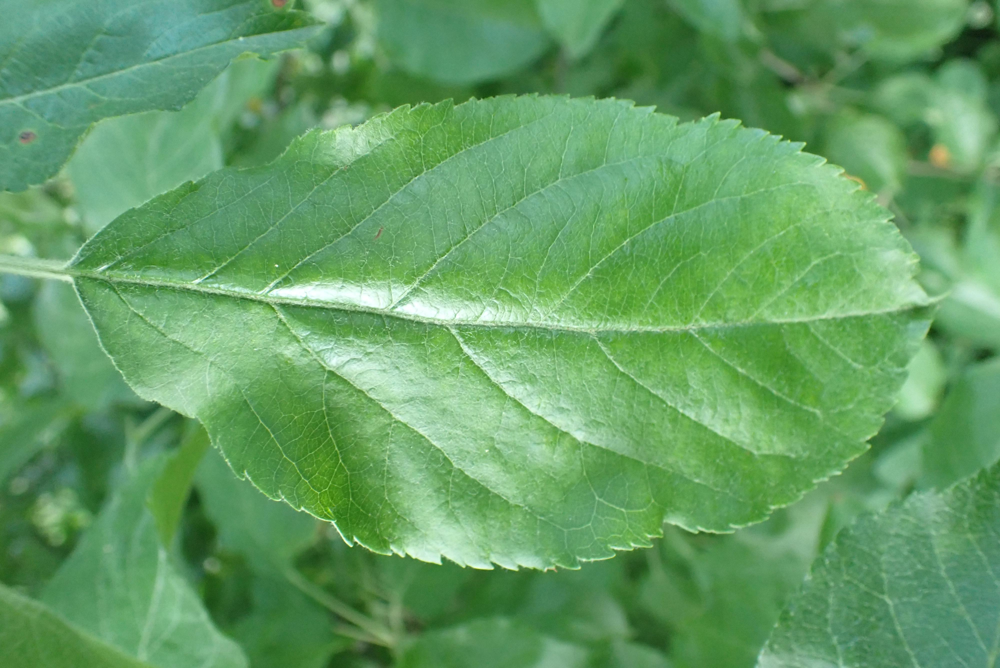

In [13]:
from PIL import Image
from IPython.display import display

# Correct full path with raw string
image_path = r"C:\Users\sp496\Downloads\plant_data\Train\Healthy\8ce77048e12f3dd4.jpg"

# Open and show image
img = Image.open(image_path)
display(img)



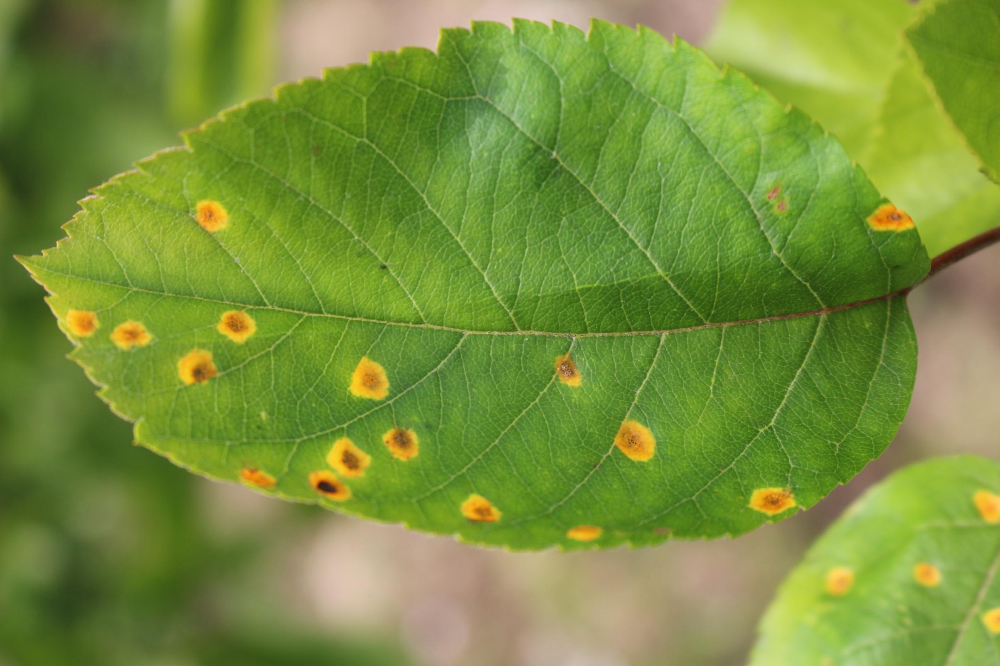

In [6]:
image_path = 'Dataset/Train/Train/Rust/80f09587dfc7988e.jpg'

with open(image_path, 'rb') as f:
    display.display(display.Image(data=f.read(), width=500))

In [16]:
pip install tensorflow

  Using cached absl_py-2.3.1-py3-none-any.whl.metadata (3.3 kB)
  Using cached astunparse-1.6.3-py2.py3-none-any.whl.metadata (4.4 kB)
  Using cached flatbuffers-25.2.10-py2.py3-none-any.whl.metadata (875 bytes)
  Using cached gast-0.6.0-py3-none-any.whl.metadata (1.3 kB)
  Using cached google_pasta-0.2.0-py3-none-any.whl.metadata (814 bytes)
  Using cached libclang-18.1.1-py2.py3-none-win_amd64.whl.metadata (5.3 kB)
  Using cached opt_einsum-3.4.0-py3-none-any.whl.metadata (6.3 kB)
  Using cached requests-2.32.5-py3-none-any.whl.metadata (4.9 kB)
  Using cached termcolor-3.1.0-py3-none-any.whl.metadata (6.4 kB)
  Using cached typing_extensions-4.15.0-py3-none-any.whl.metadata (3.3 kB)
  Using cached tensorboard-2.20.0-py3-none-any.whl.metadata (1.8 kB)
  Using cached keras-3.11.3-py3-none-any.whl.metadata (5.9 kB)
  Using cached namex-0.1.0-py3-none-any.whl.metadata (322 bytes)
  Using cached charset_normalizer-3.4.3-cp312-cp312-win_amd64.whl.metadata (37 kB)
  Using cached idna-3.10-

In [17]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(
    rescale=1./255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True
)

test_datagen = ImageDataGenerator(rescale=1./255)


In [18]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

# 1) Create data generators
train_datagen = ImageDataGenerator(
    rescale=1./255, 
    shear_range=0.2, 
    zoom_range=0.2, 
    horizontal_flip=True
)

test_datagen = ImageDataGenerator(rescale=1./255)

# 2) Point to your dataset folders
train_generator = train_datagen.flow_from_directory(
    r"C:\Users\sp496\Downloads\plant_data\Train",
    target_size=(225, 225),
    batch_size=32,
    class_mode='categorical'
)

validation_generator = test_datagen.flow_from_directory(
    r"C:\Users\sp496\Downloads\plant_data\Validation",
    target_size=(225, 225),
    batch_size=32,
    class_mode='categorical'
)

test_generator = test_datagen.flow_from_directory(
    r"C:\Users\sp496\Downloads\plant_data\Test",
    target_size=(225, 225),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)


Found 1322 images belonging to 3 classes.
Found 60 images belonging to 3 classes.
Found 150 images belonging to 3 classes.


In [19]:
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense


model = Sequential()
model.add(Conv2D(32, (3, 3), input_shape=(225, 225, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Conv2D(64, (3, 3), activation='relu'))
model.add(MaxPooling2D(pool_size=(2, 2)))
model.add(Flatten())
model.add(Dense(64, activation='relu'))
model.add(Dense(3, activation='softmax'))

d:\python\venv\Lib\site-packages\keras\src\layers\convolutional\base_conv.py:113: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


In [20]:
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [22]:
pip install scipy

   ---------------------------------------- 0.0/38.5 MB ? eta -:--:--
   - -------------------------------------- 1.3/38.5 MB 6.7 MB/s eta 0:00:06
   -- ------------------------------------- 2.9/38.5 MB 7.6 MB/s eta 0:00:05
   ---- ----------------------------------- 4.2/38.5 MB 6.6 MB/s eta 0:00:06
   ----- ---------------------------------- 5.2/38.5 MB 6.5 MB/s eta 0:00:06
   ------- -------------------------------- 6.8/38.5 MB 6.8 MB/s eta 0:00:05
   -------- ------------------------------- 8.7/38.5 MB 6.9 MB/s eta 0:00:05
   ---------- ----------------------------- 10.0/38.5 MB 7.0 MB/s eta 0:00:05
   ----------- ---------------------------- 11.5/38.5 MB 7.0 MB/s eta 0:00:04
   ------------- -------------------------- 13.1/38.5 MB 7.0 MB/s eta 0:00:04
   -------------- ------------------------- 14.4/38.5 MB 7.0 MB/s eta 0:00:04
   ---------------- ----------------------- 16.0/38.5 MB 7.0 MB/s eta 0:00:04
   ----------------- ---------------------- 17.3/38.5 MB 7.0 MB/s eta 0:00:04


In [23]:
history = model.fit(train_generator,
                    batch_size=16,
                    epochs=5,
                    validation_data=validation_generator,
                    validation_batch_size=16
                    )

Epoch 1/5
42/42 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.3865 - loss: 2.0735

d:\python\venv\Lib\site-packages\keras\src\trainers\data_adapters\py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


42/42 ━━━━━━━━━━━━━━━━━━━━ 79s 2s/step - accuracy: 0.4985 - loss: 1.2834 - val_accuracy: 0.8000 - val_loss: 0.6964
Epoch 2/5
42/42 ━━━━━━━━━━━━━━━━━━━━ 71s 2s/step - accuracy: 0.7920 - loss: 0.5039 - val_accuracy: 0.8167 - val_loss: 0.5343
Epoch 3/5
42/42 ━━━━━━━━━━━━━━━━━━━━ 71s 2s/step - accuracy: 0.8638 - loss: 0.3591 - val_accuracy: 0.8500 - val_loss: 0.4597
Epoch 4/5
42/42 ━━━━━━━━━━━━━━━━━━━━ 70s 2s/step - accuracy: 0.8971 - loss: 0.2853 - val_accuracy: 0.8500 - val_loss: 0.5203
Epoch 5/5
42/42 ━━━━━━━━━━━━━━━━━━━━ 73s 2s/step - accuracy: 0.9274 - loss: 0.2081 - val_accuracy: 0.8500 - val_loss: 0.5211


In [27]:
pip install matplotlib seaborn


  Using cached cycler-0.12.1-py3-none-any.whl.metadata (3.8 kB)
  Using cached pyparsing-3.2.3-py3-none-any.whl.metadata (5.0 kB)
  Using cached pytz-2025.2-py2.py3-none-any.whl.metadata (22 kB)
  Using cached tzdata-2025.2-py2.py3-none-any.whl.metadata (1.4 kB)
   ---------------------------------------- 0.0/8.1 MB ? eta -:--:--
   ------- -------------------------------- 1.6/8.1 MB 7.6 MB/s eta 0:00:01
   -------------- ------------------------- 2.9/8.1 MB 7.3 MB/s eta 0:00:01
   -------------------- ------------------- 4.2/8.1 MB 7.0 MB/s eta 0:00:01
   ---------------------------- ----------- 5.8/8.1 MB 7.0 MB/s eta 0:00:01
   ------------------------------------ --- 7.3/8.1 MB 7.1 MB/s eta 0:00:01
   ---------------------------------------- 8.1/8.1 MB 6.9 MB/s eta 0:00:00
Using cached cycler-0.12.1-py3-none-any.whl (8.3 kB)
   ---------------------------------------- 0.0/2.3 MB ? eta -:--:--
   --------------------------- ------------ 1.6/2.3 MB 7.6 MB/s eta 0:00:01
   -----------

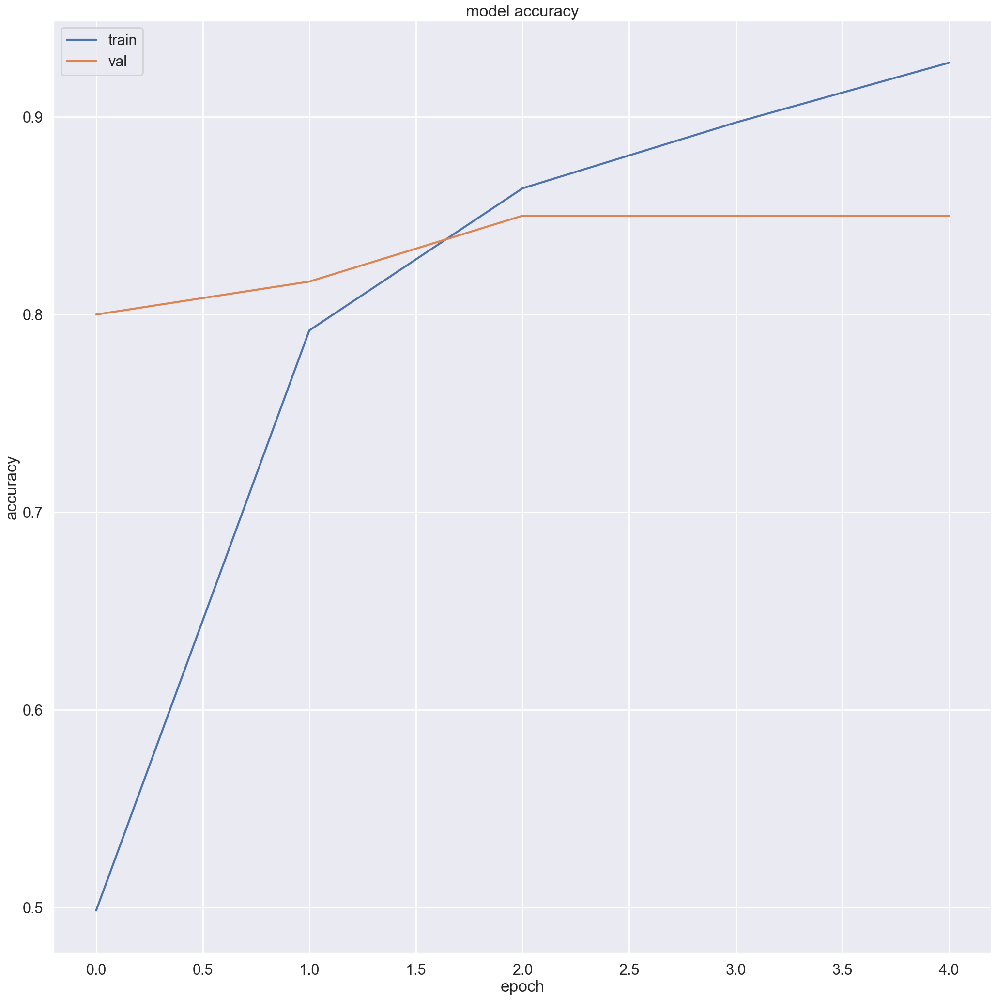

In [28]:
from matplotlib import pyplot as plt
from matplotlib.pyplot import figure

import seaborn as sns
sns.set_theme()
sns.set_context("poster")

figure(figsize=(25, 25), dpi=100)

plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('model accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'val'], loc='upper left')
plt.show()

In [29]:
model.save("my_model.keras")

In [31]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import numpy as np

def preprocess_image(image_path, target_size=(225, 225)):
    img = load_img(image_path, target_size=target_size)
    x = img_to_array(img)
    x = x.astype('float32') / 255.0
    x = np.expand_dims(x, axis=0)
    return x

# Use raw string (r"...") to avoid issues with backslashes
x = preprocess_image(
    r"C:\Users\sp496\Downloads\plant_data\Test\Rust\82f49a4a7b9585f1.jpg"
)
print("Preprocessed image shape:", x.shape)


Preprocessed image shape: (1, 225, 225, 3)


In [32]:
predictions = model.predict(x)
predictions[0]

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 71ms/step


array([2.9169999e-02, 8.9860376e-04, 9.6993142e-01], dtype=float32)

In [33]:
labels = train_generator.class_indices
labels = {v: k for k, v in labels.items()}
labels

{0: 'Healthy', 1: 'Powdery', 2: 'Rust'}

In [34]:
predicted_label = labels[np.argmax(predictions)]
print(predicted_label)

Rust


In [35]:


from pathlib import Path

# Make sure "model" folder exists
Path("model").mkdir(exist_ok=True)

# Save in new Keras format
model.save("model/plant_disease_model.keras")


